# Dx score

```{contents}
```

## Load data

In [1]:
import pandas as pd
import sys
sys.path.append('../')
from source.pacmap_functions import *

# mount = '../../../'
mount = '/mnt/d/'
input_path = mount + 'MethylScore/Intermediate_Files/'
output_path = mount + 'MethylScore/Processed_Data/'

# read df_discovery and df_validation
df_discovery = pd.read_pickle(
    input_path+'3308samples_333059cpgs_withbatchcorrection_bvalues.pkl').sort_index()

df_validation = pd.read_pickle(
    input_path+'201samples_357839cpgs_withbatchcorrection_bvalues.pkl').sort_index()

# Load clinical data
discovery_clinical_data = pd.read_csv(input_path+'discovery_clinical_data.csv',
                                      low_memory=False, index_col=0)

# Load clinical data
validation_clinical_data = pd.read_csv(input_path+'validation_clinical_data.csv',
                                        low_memory=False, index_col=0)

# Adjust clinical data
discovery_clinical_data['Train-Validation-Test'] = 'Train Samples'

validation_clinical_data['Train-Validation-Test'] = 'Test Samples'

discovery_clinical_data['PaCMAP Output'] = 'Patient Samples'
validation_clinical_data['PaCMAP Output'] = 'Patient Samples'

discovery_clinical_data['Batch'] = df_discovery['Batch']
validation_clinical_data['Batch'] = 'St Jude Children\'s'


## Select CpGs in both train and test

In [2]:
# use overlapping features between df_discovery and df_validation
common_features = [x for x in df_discovery.columns if x in df_validation.columns]

# apply `common_features` to both df_discovery and df_validation
df_discovery = df_discovery[common_features]
df_validation = df_validation[common_features]

print(
f' Discovery dataset (df_discovery) contains {df_discovery.shape[1]} \
columns (5mC nucleotides/probes) and {df_discovery.shape[0]} rows (samples).')

print(
f' Validation dataset (df_validation) contains {df_validation.shape[1]} \
columns (5mC nucleotides/probes) and {df_validation.shape[0]} rows (samples).')

output_notebook()

# Set the theme for the plot
curdoc().theme = 'dark_minimal' # or 'dark_minimal'

 Discovery dataset (df_discovery) contains 319558 columns (5mC nucleotides/probes) and 3308 rows (samples).
 Validation dataset (df_validation) contains 319558 columns (5mC nucleotides/probes) and 201 rows (samples).


Loading BokehJS ...

In [3]:
df_discovery

IlmnID,cg00000292,cg00000363,cg00000622,cg00000658,cg00000714,cg00000721,cg00000734,cg00000769,cg00000884,cg00000924,...,ch.9.79515146F,ch.9.83519450F,ch.9.84051654F,ch.9.84078312F,ch.9.86947500F,ch.9.88862796F,ch.9.90287778F,ch.9.90621653R,ch.9.93402636R,ch.9.98463211R
0003fe29-7b8f-4ef1-b9bc-40306205f1fd_noid,0.991,1.022,0.013,0.832,0.624,0.988,0.058,0.018,0.932,0.679,...,0.031,0.016,0.030,0.026,0.020,0.029,0.031,0.032,0.020,0.034
0031efba-f564-4fff-bd7b-2b97f37218c1_noid,0.817,0.422,0.014,0.791,0.269,0.831,0.066,0.021,0.900,0.545,...,0.045,0.012,0.031,0.026,0.029,0.045,0.027,0.025,0.028,0.050
0037ec75-bb9e-4dbb-a2d9-de1f9bfd2362_noid,0.795,0.590,0.014,0.865,0.355,0.954,0.067,0.020,0.932,0.529,...,0.038,0.029,0.031,0.044,0.042,0.040,0.047,0.042,0.022,0.030
003d9efe-90a1-42cf-84c4-03fbabefe60b_noid,0.845,0.332,0.013,0.845,0.275,0.949,0.068,0.026,0.923,0.537,...,0.049,0.014,0.032,0.029,0.044,0.041,0.042,0.033,0.023,0.083
004c953f-d999-4d82-898d-c091e692df3c_noid,0.879,0.357,0.014,0.839,0.242,0.979,0.072,0.024,0.938,0.544,...,0.031,0.045,0.031,0.017,0.049,0.025,0.047,0.034,0.028,0.040
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fd4e4be4-3306-4037-b4e9-7886283243ed_noid,0.924,0.648,0.012,0.892,0.337,0.972,0.072,0.016,0.944,0.625,...,0.033,0.016,0.029,0.072,0.025,0.031,0.035,0.019,0.019,0.005
fe185655-3aa5-4c5c-9dfd-630e0ee71710_noid,0.069,0.222,0.015,0.871,0.122,0.995,0.066,0.017,0.927,0.583,...,0.042,0.027,0.037,0.024,0.047,0.050,0.035,0.035,0.038,0.034
ff7f7d14-5fb7-44bc-b67a-d07610873330_noid,0.787,0.488,0.015,0.845,0.205,0.854,0.067,0.020,0.920,0.565,...,0.038,0.035,0.026,0.022,0.046,0.037,0.048,0.032,0.031,0.036
ff87c237-583a-4aa1-880c-7d77d00ba0a6_noid,0.899,0.335,0.017,0.882,0.320,0.929,0.057,0.024,0.921,0.584,...,0.045,0.028,0.032,0.054,0.039,0.044,0.038,0.029,0.036,0.033


## Acute Leukemia Methylome Atlas

In [ ]:
clinical_trials = [
                    'NOPHO ALL92-2000', 
                    'AAML0531',
                    'AAML1031',
                    'Beat AML Consortium',
                    'TCGA AML',
                    'CETLAM SMD-09 (MDS-tAML)',
                    'French GRAALL 2003–2005',
                    'TARGET ALL',
                    'AAML03P1',
                    'Japanese AML05',
                    'CCG2961'
                    ]

sample_types = ['Diagnosis', 'Primary Blood Derived Cancer - Bone Marrow', 'Bone Marrow Normal',
                'Primary Blood Derived Cancer - Peripheral Blood', 'Blood Derived Normal',
                'Relapse','Recurrent Blood Derived Cancer - Bone Marrow',
                'Recurrent Blood Derived Cancer - Peripheral Blood'
                ]

cols = ['Clinical Trial', 'Sample Type', 'Patient_ID', 'WHO 2022 Diagnosis',
        'ELN 2022 Diagnosis','Hematopoietic Entity' ,'Train Test', 'Batch']

components = [2,5]
for n in components:
    processor = DataProcessor(discovery_clinical_data.copy(),
                              df_discovery,
                              clinical_trials,
                              sample_types,
                              cols, 
                              n_components=n,
                              common_prefix=output_path+f'pacmap_output/pacmap_{n}d_model_peds_dx_al', 
                              df_test=df_validation.copy(),
                              test_clinical_data=validation_clinical_data.copy())
    
    processor.filter_data()
    processor.apply_pacmap() # learn PaCMAP on the training data
    processor.apply_pacmap_test() # apply PaCMAP to the test data
    processor.join_labels() # join clinical data to the embedding

    # Save output
    processor.df.to_csv(output_path+f'pacmap_output/pacmap_{n}d_model_dx_al.csv')

The PaCMAP instance is successfully saved at /mnt/d/MethylScore/Processed_Data/pacmap_output/pacmap_2d_model_peds_dx_al.pkl.
To load the instance again, please do `pacmap.load(/mnt/d/MethylScore/Processed_Data/pacmap_output/pacmap_2d_model_peds_dx_al)`.
The PaCMAP instance is successfully saved at /mnt/d/MethylScore/Processed_Data/pacmap_output/pacmap_5d_model_peds_dx_al.pkl.
To load the instance again, please do `pacmap.load(/mnt/d/MethylScore/Processed_Data/pacmap_output/pacmap_5d_model_peds_dx_al)`.


In [ ]:
df = pd.read_csv(output_path+'pacmap_output/pacmap_2d_model_dx_al.csv', index_col=0)

# Concatenate discovery and validation clinical data
clinical_data = pd.concat([discovery_clinical_data, validation_clinical_data]).loc[df['index']]

# Select columns to plot
cols = ['WHO 2022 Diagnosis','ELN 2022 Diagnosis','Hematopoietic Entity','FAB', 'FLT3 ITD', 'Age (group years)',
        'Complex Karyotype' ,'Batch', 'Sex', 'MRD 1 Status',
        'Leucocyte counts (10⁹/L)', 'Risk Group', 'Race or ethnic group', 'Trisomy 8 Status',
        'Clinical Trial', 'Vital Status','First Event','Sample Type', 'Train Test']

# Join clinical data to the embedding
df = df.join(clinical_data[cols], rsuffix='_copy', on='index')

plotter = BokehPlotter(df, cols, get_custom_color_palette(),
                       title='',
                        x_range=(-45, 45), y_range=(-45, 45),
                        datapoint_size=4, tooltip_dx_cols='WHO 2022 Diagnosis',
                        width=1000, height=600)
plotter.plot()

## Patient Characteristics Table

In [ ]:
from tableone import TableOne

columns = ['Hematopoietic Entity',
            'Clinical Trial',]

df_train = df[df['Train Test']=='Discovery (train) Samples']

mytable_cog = TableOne(df_train.reset_index(), columns,
                        overall=False, missing=False,
                        pval=False, pval_adjust=False,
                        htest_name=True,dip_test=True,
                        tukey_test=True, normal_test=True,

                        order={'FLT3 ITD':['Yes','No'],
                                'Age (group years)':['0-5','5-13','13-39','39-60'],
                                'MRD 1 Status': ['Positive'],
                                'Risk Group': ['High Risk', 'Standard Risk'],
                                'FLT3 ITD': ['Yes'],
                                'Leucocyte counts (10⁹/L)': ['≥30'],
                                'Age group (years)': ['≥10']})

# mytable_cog.to_excel('data/tableone_Dx_pacmap.xlsx')
# mytable_cog.to_csv(output_path + 'pacmap_output/tableone_Dx_pacmap.csv')

mytable_cog.tabulate(tablefmt="html", 
                        # headers=[score_name,"",'Missing','Discovery','Validation','p-value','Statistical Test']
                        )

,,Overall
n,,3047
"Hematopoietic Entity, n (%)",Acute lymphoblastic leukemia (ALL),700 (31.3)
,Acute myeloid leukemia (AML),1185 (53.0)
,Acute promyelocytic leukemia (APL),31 (1.4)
,Mixed phenotype acute leukemia (MPAL),50 (2.2)
,Myelodysplastic syndrome (MDS or MDS-like),142 (6.4)
,Otherwise-Normal (Control),128 (5.7)
"Clinical Trial, n (%)",AAML03P1,72 (2.4)
,AAML0531,628 (20.6)
,AAML1031,581 (19.1)


## Load data for multi-class classifier

In [ ]:
import pandas as pd
import numpy as np

input_path = '/mnt/d/MethylScore/Intermediate_Files/'
output_path = '/mnt/d/MethylScore/Processed_Data/'

n_components = 5

# Create a list of strings containing "PaCMAP " + the number of components
components = [f'PaCMAP {i}' for i in range(1, n_components+1)]

# Load pacmap output data
df = pd.read_csv(output_path+f'pacmap_output/pacmap_{n_components}d_model_dx_al.csv', index_col=0)

## Preprocess data

### Select WHO 2022 annotated samples

In [ ]:
# drop the samples with missing labels for the ELN AML 2022 Diagnosis
df_original = df.copy()
df = df[~df['WHO 2022 Diagnosis'].isna()]

# drop samples from `df['Hematopoietic Entity']` that contain `ALL` and `MPAL` and `Otherwise-Normal Control` and `APL`
# df = df[df['Hematopoietic Entity'].isin(['Acute myeloid leukemia (AML)'])]

# print the number of samples dropped and the amount remaining
print(df_original.shape[0]-df.shape[0], 'samples removed.'\
, df.shape[0], 'samples remaining.')

896 samples removed. 2352 samples remaining.


### Select Dx subtypes with at least 10 samples

In [ ]:
df['WHO 2022 Diagnosis'].value_counts(dropna=False)

WHO 2022 Diagnosis
AML with t(v;11q23); KMT2A-r               363
T-ALL NOS                                  242
AML with mutated NPM1                      226
AML with t(8;21); RUNX1::RUNX1T1           204
AML with inv(16); t(16;16); CBFB::MYH11    201
B-ALL with hyperdiploidy                   190
B-ALL with t(12;21); ETV6::RUNX1           163
MDS-related; secondary myeloid             152
Otherwise-Normal Control                   128
AML with NUP98-fusion                       95
AML with mutated CEBPA                      87
APL with t(15;17); PML::RARA                31
AML with CBFA2T3::GLIS2                     30
B-ALL with t(v;11q23); KMT2A-r              29
AML with t(6;9); DEK::NUP214                27
MPAL T-Lymphoblastic/Myeloid                25
B-ALL with t(1;19); TCF3::PBX1              23
B-ALL dic(9;20)                             20
MPAL B-Lymphoblastic/Myeloid                19
B-ALL with t(9;22); BCR::ABL1               19
AML with ETV6 fusion                     

In [ ]:
# exclude the samples with mixed phenotypes and Down syndrome and t(9;22)(q34.1;q11.2)/BCR::ABL1
df2 = df[~df['WHO 2022 Diagnosis'].isin([
                                    # 'MPAL with t(v;11q23.3)/KMT2A-r',
                                    #    'B-ALL with hypodiploidy',
                                       # 'AML with t(9;22); BCR::ABL1'
                                       ])]

# print the number of samples dropped and the amount remaining
print(df.shape[0]-df2.shape[0], 'samples removed.'\
, df2.shape[0], 'samples remaining, which includes 111 test samples')
                                       

0 samples removed. 2352 samples remaining, which includes 111 test samples


### Define X and y

In [ ]:

# Define X and y
X = df2[components].to_numpy() # shape (n_samples=1399, n_features=5)
y = df2['WHO 2022 Diagnosis'].to_numpy() # shape (n_samples=1399,) with 11 string classes

# Split the data into train/test sets based on the `Train Test` column
X_train = X[df2['Train Test']=='Discovery (train) Samples']
y_train = y[df2['Train Test']=='Discovery (train) Samples']
X_test = X[df2['Train Test']=='Validation (test) Samples']
y_test = y[df2['Train Test']=='Validation (test) Samples']

# print the number of samples in each set
print('X_train shape:', X_train.shape, 'X_test shape:', X_test.shape)

X_train shape: (2236, 5) X_test shape: (116, 5)


## LightGBM

### 5 components

In [ ]:
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score
import sys

sys.path.append('../')
from source.data_visualization_functions import plot_confusion_matrix_stacked

# param_grid = {}

# Define the parameter grid
# param_grid = {
#     'num_leaves': [100], # number of leaves in full tree, which will roughly be the same as max number of features in one-hot encoding
#     'learning_rate': [0.01],  # learning rate
#     'n_estimators': [200],  # number of trees (or rounds)
# }

param_grid = {
    'num_leaves': [30, 50, 100, 200], # number of leaves in full tree, which will roughly be the same as max number of features in one-hot encoding
    'learning_rate': [0.01, 0.1, 0.2],  # learning rate
    'n_estimators': [30, 50, 100, 200, 300]  # number of trees (or rounds)
}

# Initialize the LGBM Classifier
lgbm = LGBMClassifier(random_state=42, n_jobs=-1)

# Initialize StratifiedKFold
# stratified_kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=42, )

# Perform grid search with stratified cross-validation
grid_search = GridSearchCV(lgbm, param_grid, cv=3, n_jobs=-1, scoring='roc_auc_ovr_weighted', verbose=0)
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best cross-validation score (not final): {grid_search.best_score_:.3f}")

# Fit and predict using the best estimator
best_model = grid_search.best_estimator_

y_pred_train = best_model.predict(X_train)  # Predict using the best model
y_pred_test = best_model.predict(X_test)  # Predict using the best model


print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

Best parameters: {'learning_rate': 0.01, 'n_estimators': 200, 'num_leaves': 50}
Best cross-validation score (not final): 0.966
Overall accuracy score with best estimator in train: 0.955
Overall accuracy score with best estimator in test: 0.810


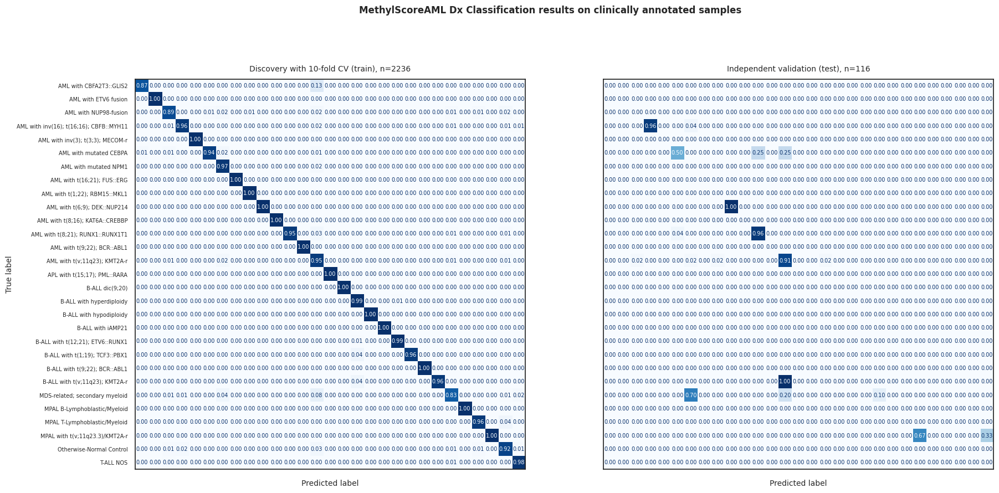

In [ ]:
plot_confusion_matrix_stacked(best_model, X_train, y_train, X_test, y_test,
                              tick_fontsize=7, label_fontsize=7, figsize = (20,10))

In [ ]:
import numpy as np
#  Select necessary columns and set the index
df_selected = df_original.set_index('index')[['PaCMAP 1', 'PaCMAP 2', 'PaCMAP 3', 'PaCMAP 4', 'PaCMAP 5']]

# Predict using the selected columns
predictions = best_model.predict(df_selected)

# Predict probabilities using the selected columns
probabilities = best_model.predict_proba(df_selected)

# Convert predictions to a Series with the same index as df_selected
predictions_series = pd.Series(predictions, index=df_selected.index, name='MethylScoreAML_Dx_predictions')

# Convert probabilities to a DataFrame with the same index as df_selected and the same columns as the classes
probabilities_df = pd.DataFrame(probabilities, index=df_selected.index, columns=best_model.classes_).round(3)

# Add " - predict_proba" to the column names
probabilities_df.columns = probabilities_df.columns + ' - predict_proba'

# Create a new column named "Confident" and set it to True if the max probability is >= 0.8
confidence_threshold = 0.8
probabilities_df['Confidence >=' + str(confidence_threshold)] = probabilities_df.max(axis=1) >= confidence_threshold

# Join predictions with the original DataFrame (already indexed)
df_joined = df_original.set_index('index').join(predictions_series).join(probabilities_df)

# # Select AML-only trials only
# df_joined = df_joined[~df_joined['Clinical Trial'].isin(['NOPHO ALL92-2000', 'French GRAALL 2003–2005','TARGET ALL', np.nan])]

# # For 'ELN AML 2022 Diagnosis', replace `na` with "AML, NOS (not otherwise specified)"
# df_joined['ELN 2022 Diagnosis'] = df_joined['ELN 2022 Diagnosis'].fillna('AML, NOS (not otherwise specified)')

# Write the final DataFrame to a CSV file
# df_joined.to_csv(output_path+'classifier_output/pacmap_5d_output_acute_leukemia_with_predictions.csv')
df_joined.to_excel('../data/pacmap_5d_output_acute_leukemia_with_predictions.xlsx')

## Gaussian Process Classifier

In [ ]:
# from sklearn.gaussian_process import GaussianProcessClassifier

# # Define the parameter grid
# param_grid = {
#     'multi_class': ['one_vs_rest'],  # one_vs_rest is the only option for multi-class classification
# }

# # Initialize the Gaussian Process Classifier
# gpc = GaussianProcessClassifier(random_state=42, n_jobs=-1)

# # Perform grid search with cross-validation
# grid_search = GridSearchCV(gpc, param_grid, cv=3, n_jobs=-1, scoring='roc_auc_ovr_weighted')
# grid_search.fit(X_train, y_train)

# # Fit and predict using the best estimator
# best_model = grid_search.best_estimator_

# y_pred = best_model.predict(X_test)  # Predict using the best model

# # Print the best parameters and the best score
# print(f"Best parameters: {grid_search.best_params_}")
# print(f"Best cross-validation score: {grid_search.best_score_:.3f}")

# # Fit and predict using the best estimator
# best_model = grid_search.best_estimator_

# y_pred_train = best_model.predict(X_train)  # Predict using the best model
# y_pred_test = best_model.predict(X_test)  # Predict using the best model


# print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
# print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

# plot_confusion_matrix_stacked(best_model, X_train, y_train, X_test, y_test,
#                               tick_fontsize=7, label_fontsize=7, figsize = (20,10))


## Random Forest Classifier

In [ ]:
# from sklearn.ensemble import RandomForestClassifier

# # Define the parameter grid
# param_grid = {
#     'n_estimators': [10, 50, 100, 200],  # number of trees in the forest
#     'max_depth': [None, 5, 10, 20, 50],  # maximum depth of the tree

# }

# # Initialize the Random Forest Classifier
# rf = RandomForestClassifier(random_state=42, n_jobs=-1)

# # Perform grid search with cross-validation
# grid_search = GridSearchCV(rf, param_grid, cv=3, n_jobs=-1, scoring='roc_auc_ovr_weighted')
# grid_search.fit(X_train, y_train)

# # Print the best parameters and the best score
# print(f"Best parameters: {grid_search.best_params_}")
# print(f"Best cross-validation score: {grid_search.best_score_:.3f}")

# # Fit and predict using the best estimator
# best_model = grid_search.best_estimator_

# y_pred_train = best_model.predict(X_train)  # Predict using the best model
# y_pred_test = best_model.predict(X_test)  # Predict using the best model


# print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
# print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

# plot_confusion_matrix_stacked(best_model, X_train, y_train, X_test, y_test,
#                               tick_fontsize=7, label_fontsize=7, figsize = (20,10))



## Watermark

In [ ]:
%load_ext watermark

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark


In [ ]:
# watermark with all libraries used in this notebook
%watermark -v -p numpy,pandas,bokeh,pacmap,itables -a Francisco_Marchi@Lamba_Lab_UF -d -m

Author: Francisco_Marchi@Lamba_Lab_UF

Python implementation: CPython
Python version       : 3.8.16
IPython version      : 8.12.2

numpy  : 1.24.3
pandas : 2.0.2
bokeh  : 3.1.1
pacmap : 0.7.0
itables: 1.5.2

Compiler    : GCC 11.3.0
OS          : Linux
Release     : 5.15.133.1-microsoft-standard-WSL2
Machine     : x86_64
Processor   : x86_64
CPU cores   : 20
Architecture: 64bit

